# Style transform
### source:
https://www.tensorflow.org/tutorials/generative/style_transfer#visualize_the_input

https://www.kaggle.com/code/basu369victor/style-transfer-deep-learning-algorithm/notebook

In [1]:
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import tensorflow as tf
from keras import backend as K
#from keras.preprocessing.image import load_img, save_img, img_to_array
from tensorflow.keras.utils import load_img, save_img, img_to_array
from keras.applications import vgg19
from keras.models import Model
#from keras import optimizers
from scipy.optimize import fmin_l_bfgs_b
#from keras.applications.vgg19 import VGG19
#vgg19_weights = '../input/vgg19/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5'
#vgg19 = VGG19(include_top = False, weights=vgg19_weights)
print(os.listdir("best-artworks-of-all-time"))


# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

['artists.csv', 'images', 'resized']


In [2]:
import IPython.display as display
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (6,6)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools

In [3]:
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

# Step1: Load dataset

In [4]:
files = os.listdir('best-artworks-of-all-time')

In [5]:
ContentPath = 'best-artworks-of-all-time/images/images/Caravaggio'
StylePath1 = 'best-artworks-of-all-time/images/images/Paul_Gauguin'
StylePath2 = 'best-artworks-of-all-time/images/images/Paul_Klee'
StylePath3 = 'best-artworks-of-all-time/images/images'

In [6]:
content_path = ContentPath + '/Caravaggio_5.jpg'
style_path1 = StylePath1 + '/Paul_Gauguin_128.jpg'
style_path2 = StylePath2 + '/Paul_Klee_13.jpg'
style_path3 = StylePath2 + '/Paul_Klee_129.jpg'
style_path4 = StylePath2 + '/Paul_Klee_148.jpg'
style_path5 = StylePath3 + '/Michelangelo/Michelangelo_47.jpg'
style_path6 = StylePath3 + '/Claude_Monet/Claude_Monet_66.jpg'
style_path7 = StylePath3 + '/Andy_Warhol/Andy_Warhol_142.jpg'
style_path8 = StylePath3 + '/Vasiliy_Kandinskiy/Vasiliy_Kandinskiy_4.jpg'
style_path9 = StylePath3 + '/Marc_Chagall/Marc_Chagall_119.jpg'

### Load imgs to see

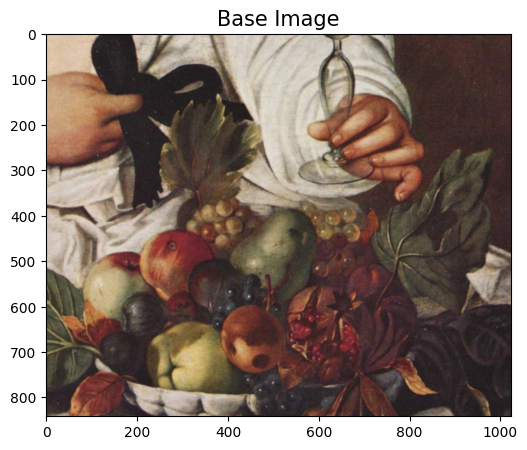

In [7]:
plt.figure()
plt.title("Base Image",fontsize=15)
img1 = load_img(content_path)
plt.imshow(img1)

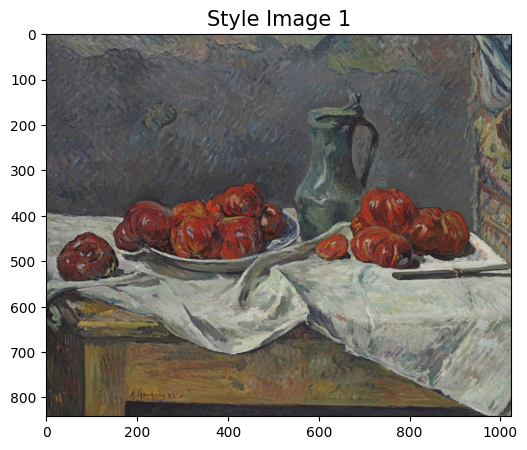

In [8]:
plt.figure()
plt.title("Style Image 1",fontsize=15)
img1 = load_img(style_path1)
plt.imshow(img1)

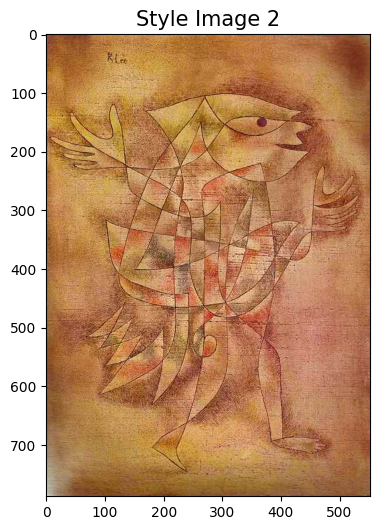

In [9]:
plt.figure()
plt.title("Style Image 2",fontsize=15)
img1 = load_img(style_path2)
plt.imshow(img1)

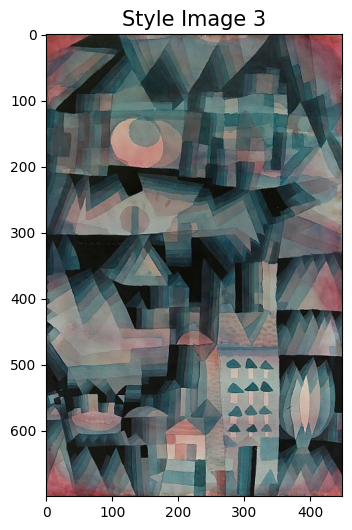

In [10]:
plt.figure()
plt.title("Style Image 3",fontsize=15)
img1 = load_img(style_path3)
plt.imshow(img1)

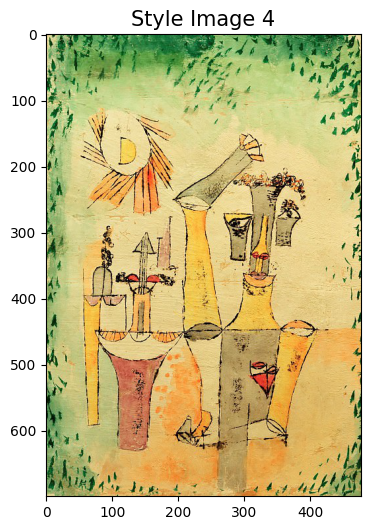

In [11]:
plt.figure()
plt.title("Style Image 4",fontsize=15)
img1 = load_img(style_path4)
plt.imshow(img1)

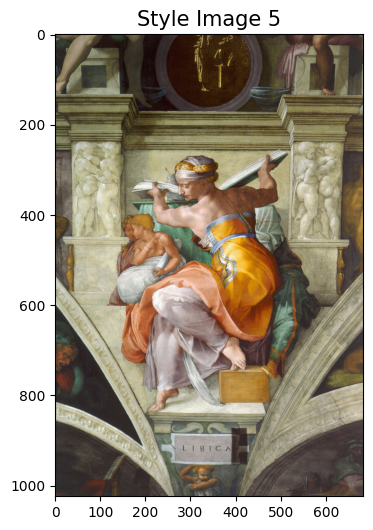

In [12]:
plt.figure()
plt.title("Style Image 5",fontsize=15)
img1 = load_img(style_path5)
plt.imshow(img1)

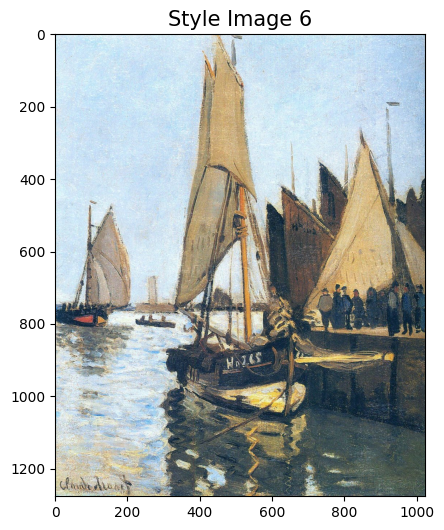

In [13]:
plt.figure()
plt.title("Style Image 6",fontsize=15)
img1 = load_img(style_path6)
plt.imshow(img1)

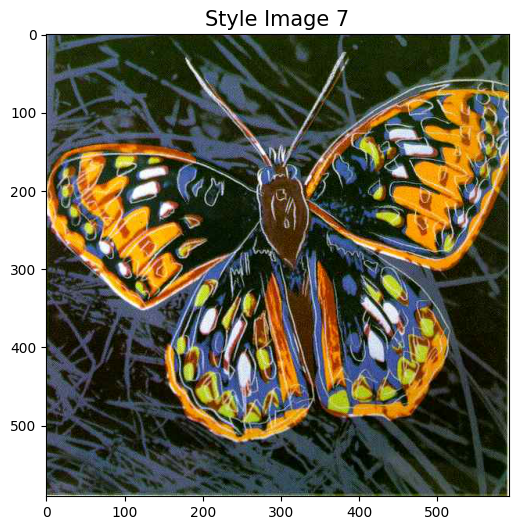

In [14]:
plt.figure()
plt.title("Style Image 7",fontsize=15)
img1 = load_img(style_path7)
plt.imshow(img1)

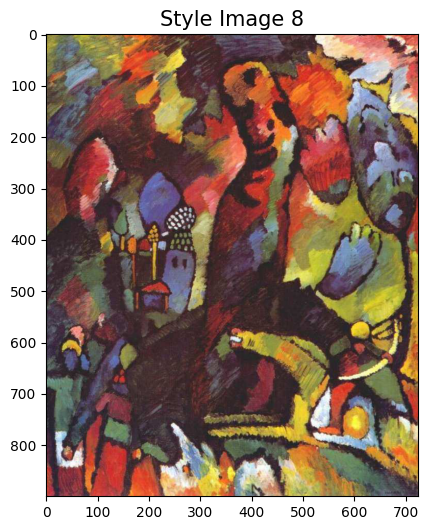

In [15]:
plt.figure()
plt.title("Style Image 8",fontsize=15)
img1 = load_img(style_path8)
plt.imshow(img1)

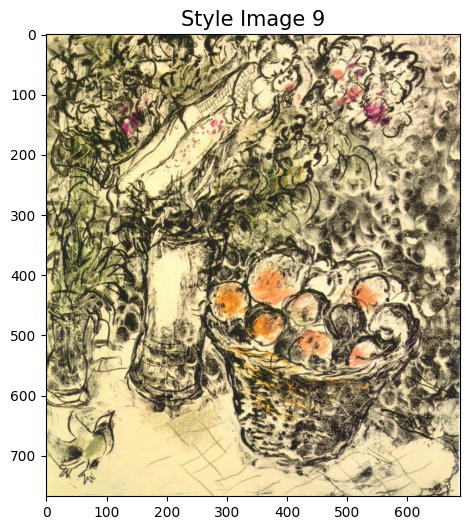

In [16]:
plt.figure()
plt.title("Style Image 9",fontsize=15)
img1 = load_img(style_path9)
plt.imshow(img1)

### resize and group content image and style image

In [17]:
def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

In [18]:
def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)

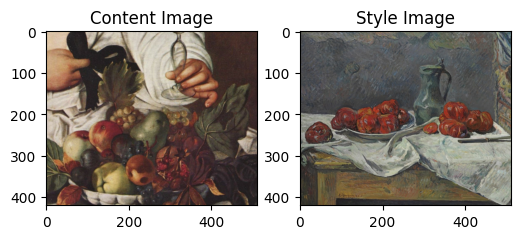

In [19]:
content_image = load_img(content_path)
style_image1 = load_img(style_path1)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image1, 'Style Image')

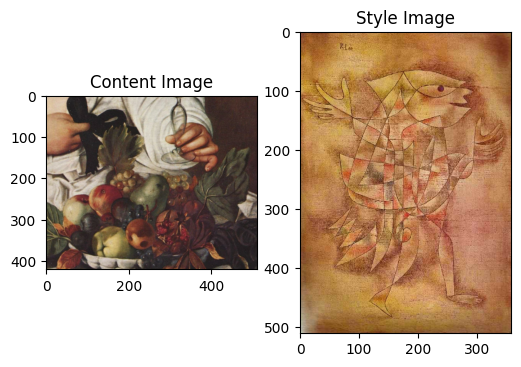

In [20]:
content_image = load_img(content_path)
style_image2 = load_img(style_path2)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image2, 'Style Image')

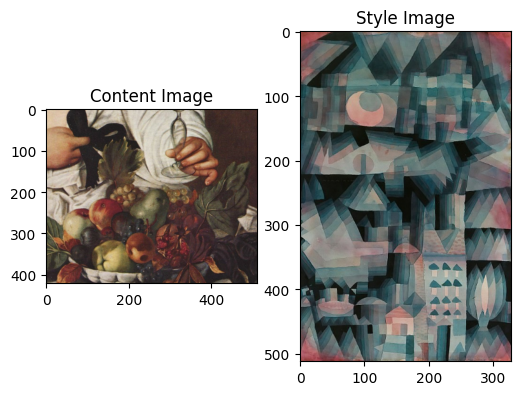

In [21]:
content_image = load_img(content_path)
style_image3 = load_img(style_path3)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image3, 'Style Image')# change here for different style reference

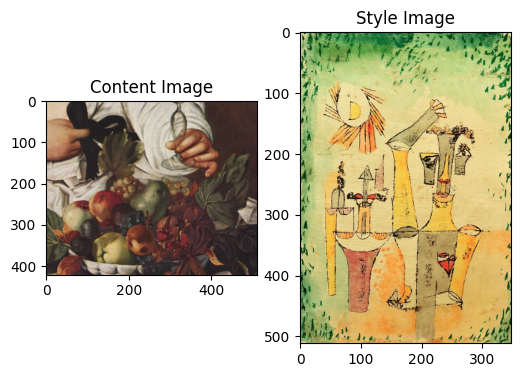

In [22]:
content_image = load_img(content_path)
style_image4 = load_img(style_path4)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image4, 'Style Image')# change here for different style reference

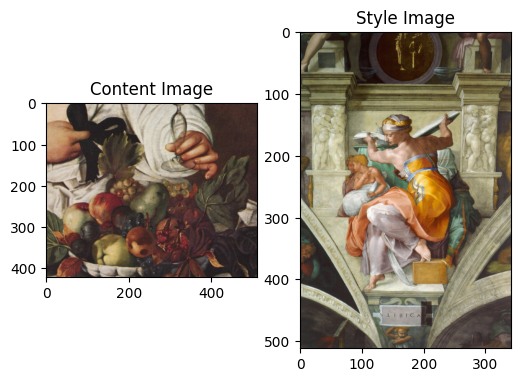

In [23]:
content_image = load_img(content_path)
style_image5 = load_img(style_path5)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image5, 'Style Image')

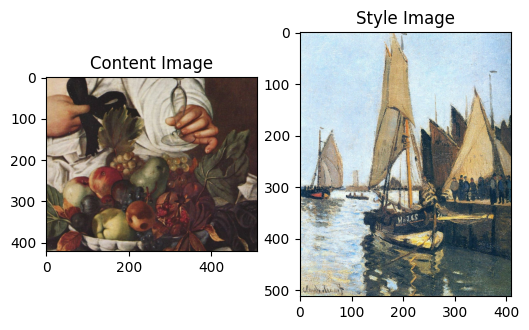

In [24]:
content_image = load_img(content_path)
style_image6 = load_img(style_path6)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image6, 'Style Image')

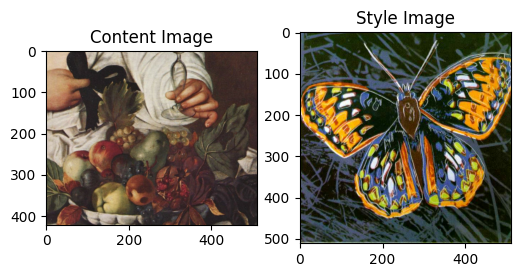

In [25]:
content_image = load_img(content_path)
style_image7 = load_img(style_path7)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image7, 'Style Image')

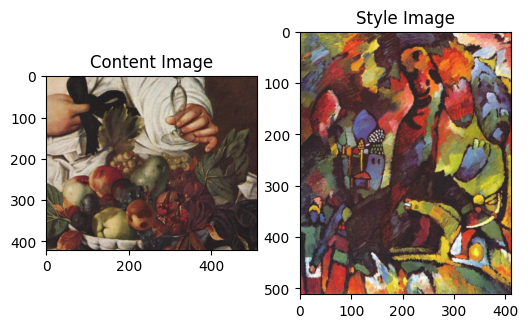

In [26]:
content_image = load_img(content_path)
style_image8 = load_img(style_path8)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image8, 'Style Image')

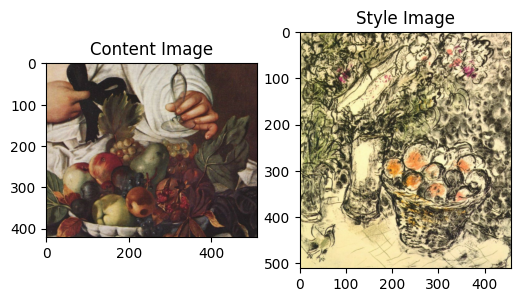

In [27]:
content_image = load_img(content_path)
style_image9 = load_img(style_path9)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image9, 'Style Image')

## Exploration 1: Using Tenserflow hub to transform style

source from: https://www.tensorflow.org/tutorials/generative/style_transfer#visualize_the_input

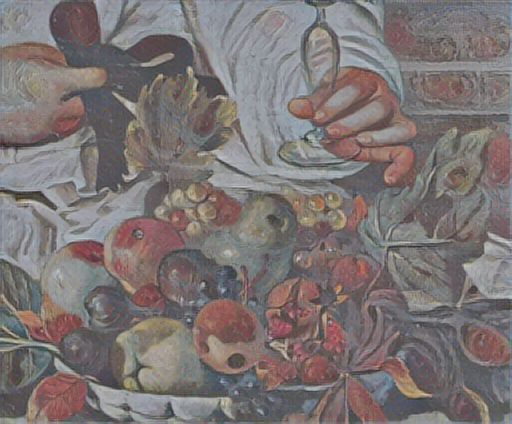

In [28]:

import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image1 = hub_model(tf.constant(content_image), tf.constant(style_image1))[0]
tensor_to_image(stylized_image1)


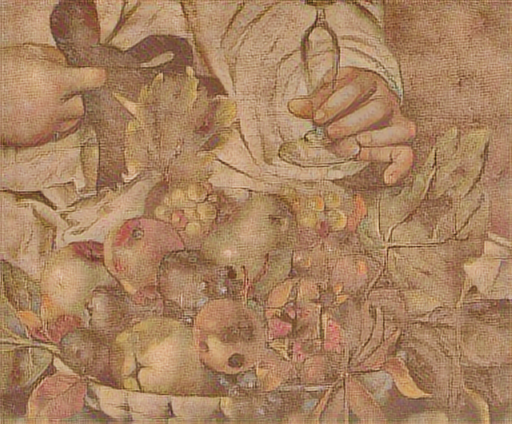

In [29]:

import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image2 = hub_model(tf.constant(content_image), tf.constant(style_image2))[0]
tensor_to_image(stylized_image2)


In [30]:
#import tensorflow_hub as hub
#hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
#stylized_image3 = hub_model(tf.constant(content_image), tf.constant(style_image3))[0]


#stylized_image4 = hub_model(tf.constant(content_image), tf.constant(style_image4))[0]


#img3 = tensor_to_image(stylized_image3)
#img4 = tensor_to_image(stylized_image4)


#def imshow(image, title=None):
   # if isinstance(image, np.ndarray):
     #   if len(image.shape) > 4:
      #      image = np.squeeze(image, axis=0)
      #  plt.imshow(image)
 #   else:
   #     plt.imshow(image)
  #  if title:
  #      plt.title(title)
  #  plt.axis("off")
   # plt.show()
    
#plt.subplot(1, 2, 1)
#imshow(img3, 'Style3')

#plt.subplot(1, 2, 2)
#imshow(img4, 'Style4')


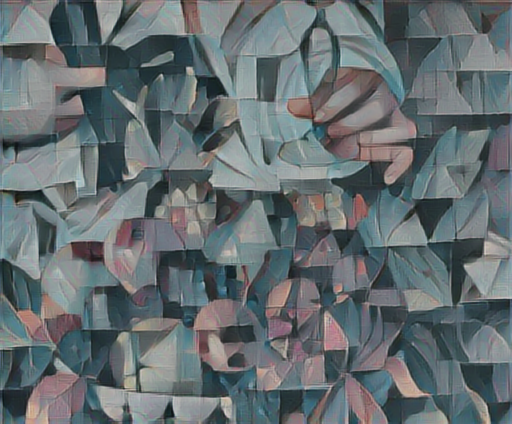

In [31]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image3 = hub_model(tf.constant(content_image), tf.constant(style_image3))[0]
tensor_to_image(stylized_image3)

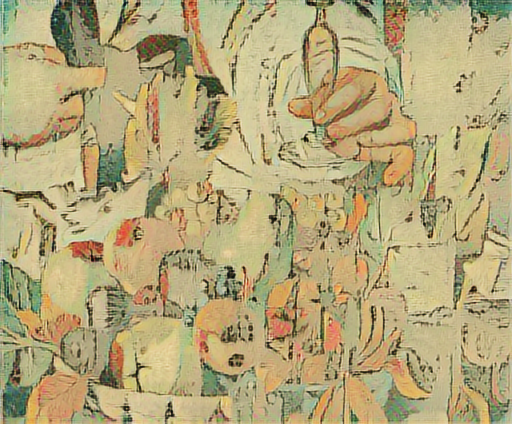

In [32]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image4 = hub_model(tf.constant(content_image), tf.constant(style_image4))[0]
tensor_to_image(stylized_image4)

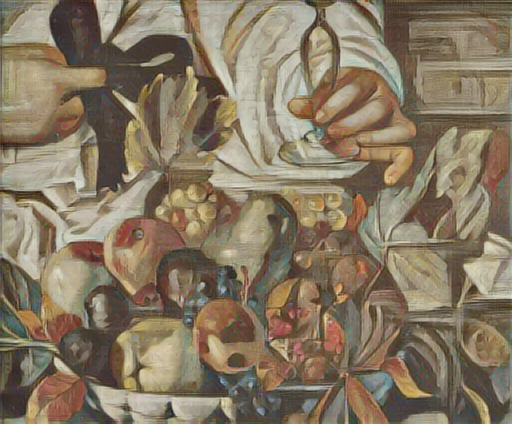

In [33]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image5 = hub_model(tf.constant(content_image), tf.constant(style_image5))[0]
tensor_to_image(stylized_image5)

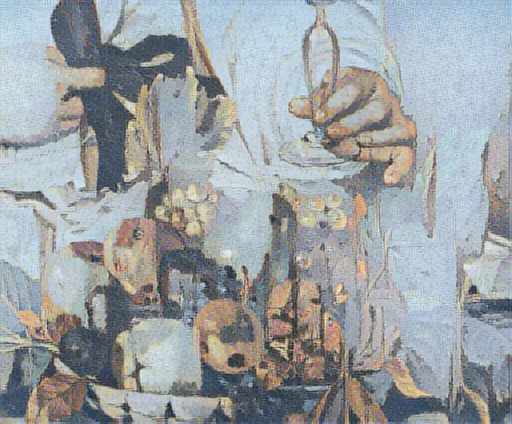

In [34]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image6 = hub_model(tf.constant(content_image), tf.constant(style_image6))[0]
tensor_to_image(stylized_image6)

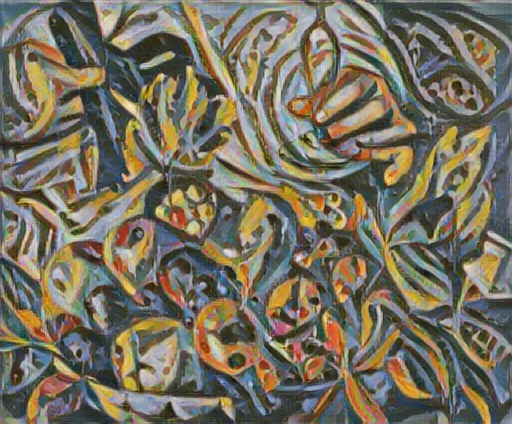

In [35]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image7 = hub_model(tf.constant(content_image), tf.constant(style_image7))[0]
tensor_to_image(stylized_image7)

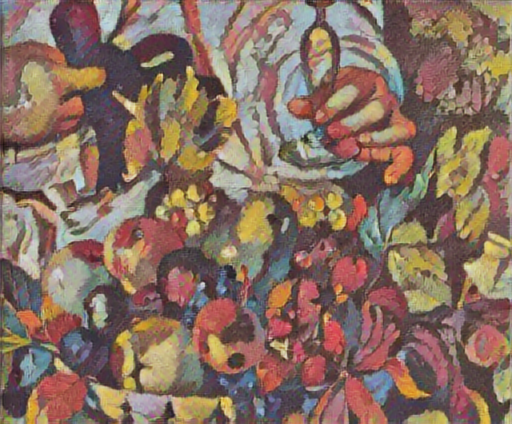

In [36]:
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image8 = hub_model(tf.constant(content_image), tf.constant(style_image8))[0]
tensor_to_image(stylized_image8)

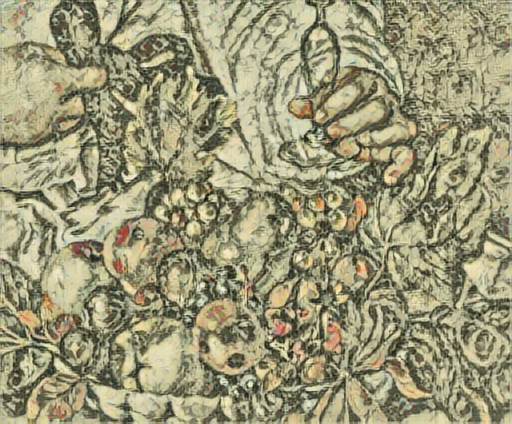

In [37]:
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image9 = hub_model(tf.constant(content_image), tf.constant(style_image9))[0]
tensor_to_image(stylized_image9)

## Exploration 2 : VGG network

Though there are some good pictures generated by Tensorflow hub, the outcomes are still has some defects. So I tried another way of stranfer style. VGG is a model for classification, while some notebooks using it to do style transfer work.
For example:

https://www.kaggle.com/code/basu369victor/style-transfer-deep-learning-algorithm/notebook

https://www.kaggle.com/code/yvtsanlevy/style-transfer-with-cnn#Introduction

https://www.kaggle.com/code/medericcar/neural-style-transfer

These code from 
https://www.tensorflow.org/tutorials/generative/style_transfer#visualize_the_input

In [38]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape

TensorShape([1, 1000])

In [39]:
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

[('hamper', 0.07768642),
 ('head_cabbage', 0.07253947),
 ('buckeye', 0.070883766),
 ('maraca', 0.043410514),
 ('tray', 0.034802213)]

In [40]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
#vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
print()
for layer in vgg.layers:
  print(layer.name)


input_2
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [41]:
#content_layers = ['block5_conv2'] 

#style_layers = ['block1_conv1',
               # 'block2_conv1',
               # 'block3_conv1', 
               # 'block4_conv1', 
                #'block5_conv1']

#num_content_layers = len(content_layers)
#num_style_layers = len(style_layers)

In [42]:
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

### 2.1 Build model

In [43]:
def vgg_layers(layer_names):
  """ Creates a VGG model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on ImageNet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False

  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model

In [44]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image1*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
  print(name)
  print("  shape: ", output.numpy().shape)
  print("  min: ", output.numpy().min())
  print("  max: ", output.numpy().max())
  print("  mean: ", output.numpy().mean())
  print()

block1_conv1
  shape:  (1, 421, 512, 64)
  min:  0.0
  max:  686.6703
  mean:  19.020256

block2_conv1
  shape:  (1, 210, 256, 128)
  min:  0.0
  max:  3292.2495
  mean:  107.72083

block3_conv1
  shape:  (1, 105, 128, 256)
  min:  0.0
  max:  6203.9414
  mean:  97.36011



### 2.2 Calculate style

In [45]:
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

In [46]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg = vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}

In [47]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.015999855
    max:  16402.41
    mean:  302.1966

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  41694.383
    mean:  9911.125

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.11936634
    max:  192740.81
    mean:  9704.459

Contents:
   block5_conv2
    shape:  (1, 26, 32, 512)
    min:  0.0
    max:  1106.3055
    mean:  14.7058735


### Gradient descent

#### (1) Style_image1; Style_weight = 0.001

In [48]:
style_targets = extractor(style_image1)['style']
content_targets = extractor(content_image)['content']

In [49]:
image = tf.Variable(content_image)

In [50]:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [51]:
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

In [52]:
#style_weight=1e-2
#content_weight=1e4

style_weight=0.001
content_weight=0.025

In [53]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

In [54]:
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

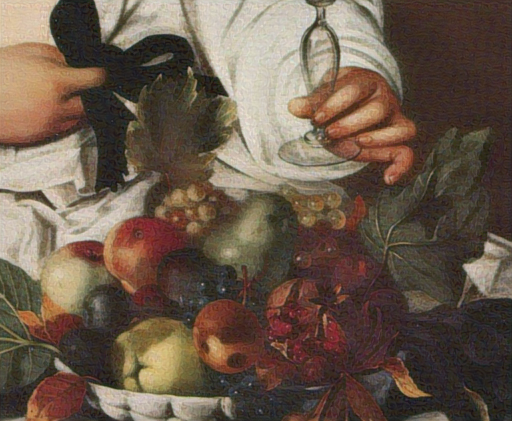

In [55]:
train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

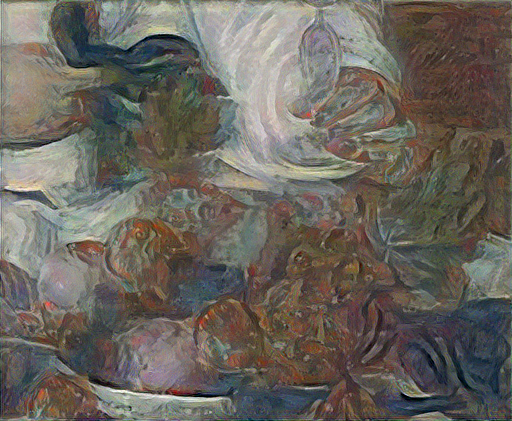

Train step: 100
Total time: 148.4


In [56]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 10

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

#### (2) Style_image5; style_weight=0.05

In [57]:
style_targets = extractor(style_image5)['style']
content_targets = extractor(content_image)['content']

In [58]:
image = tf.Variable(content_image)

In [59]:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [60]:
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

In [61]:
style_weight=0.05
content_weight=0.02

In [62]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

In [63]:
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

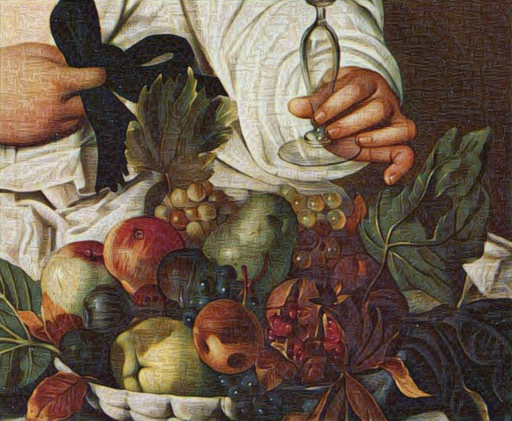

In [64]:
train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

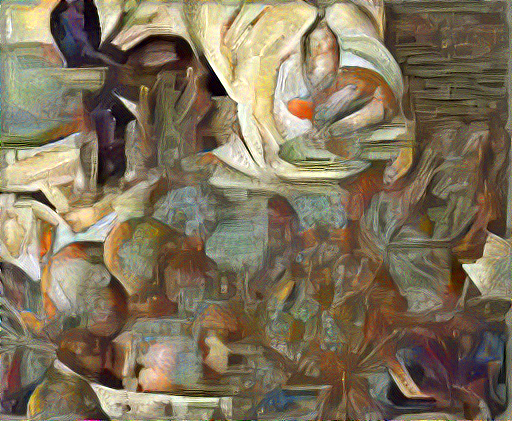

Train step: 200
Total time: 287.9


In [65]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 20

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

### (3) Style8 with different weight of style and different weight of content

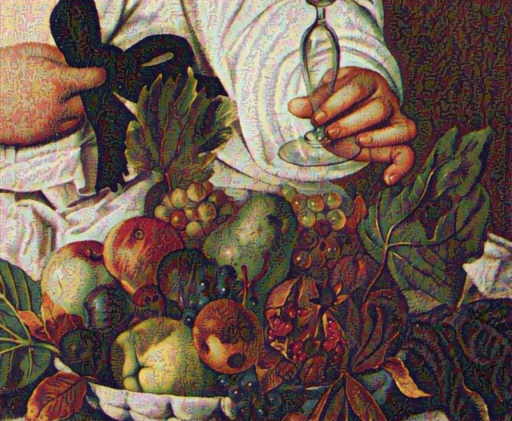

In [66]:
style_targets = extractor(style_image8)['style']
content_targets = extractor(content_image)['content']

image = tf.Variable(content_image)

def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

style_weight=0.08
content_weight=0.05

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

#### (3.1) epochs =10 steps_per_epoch =10

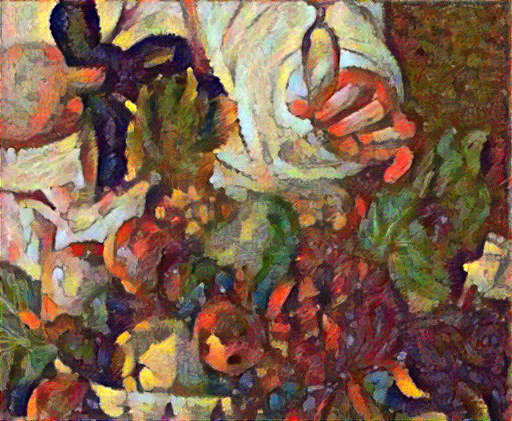

Train step: 100
Total time: 148.7


In [67]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 10

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

#### (3.2) epochs =5 steps_per_epoch =30

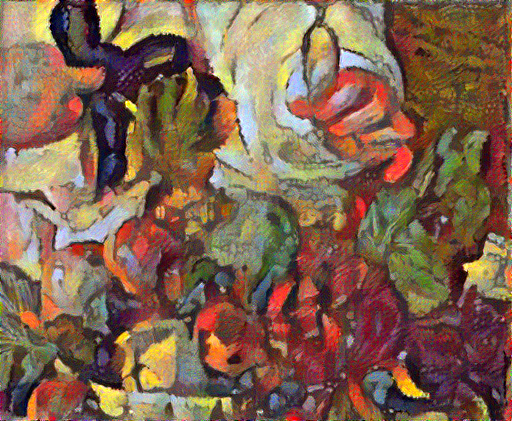

Train step: 150
Total time: 238.8


In [68]:
import time
start = time.time()

epochs = 5
steps_per_epoch = 30

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

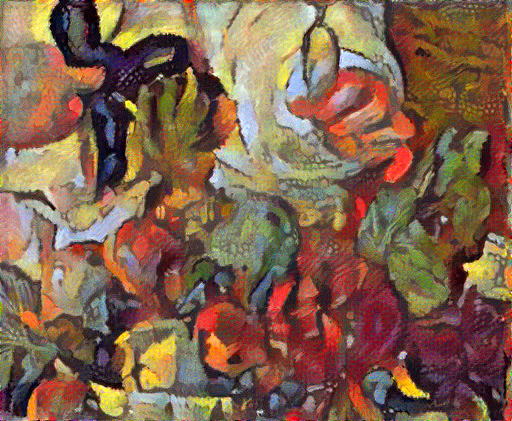

Train step: 150
Total time: 221.1


In [69]:
import time
start = time.time()

epochs = 50
steps_per_epoch = 3

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

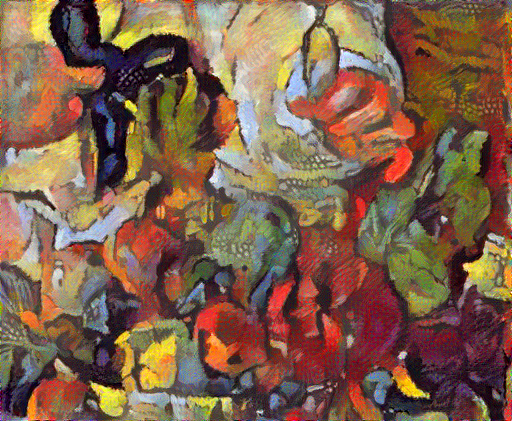

Train step: 500
Total time: 730.3


In [70]:
import time
start = time.time()

epochs = 100
steps_per_epoch = 5

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

#### (4) style9

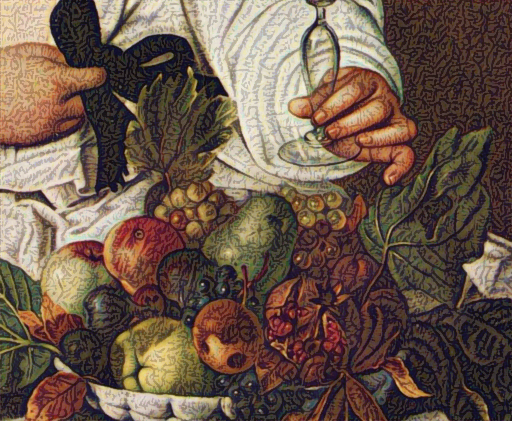

In [71]:
style_targets = extractor(style_image9)['style']
content_targets = extractor(content_image)['content']

image = tf.Variable(content_image)

def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

style_weight=0.005
content_weight=0.002

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

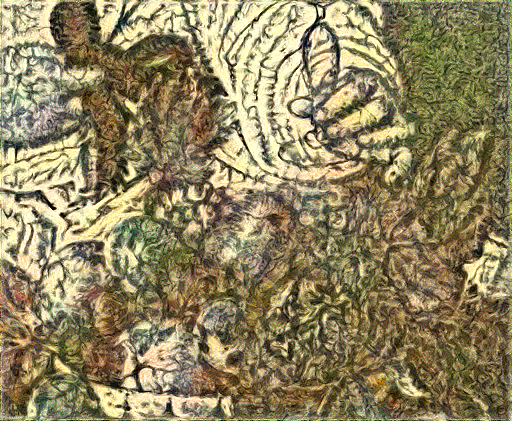

Train step: 150
Total time: 216.8


In [72]:
import time
start = time.time()

epochs = 5
steps_per_epoch = 30

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

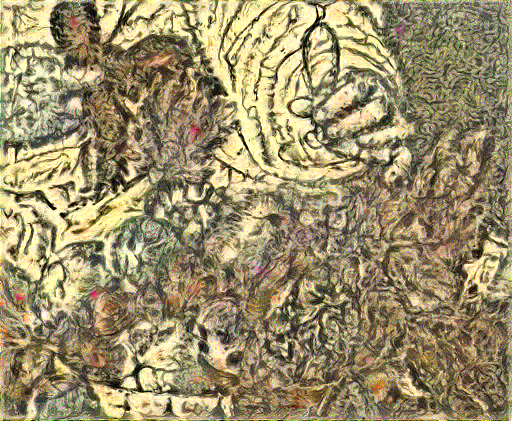

Train step: 150
Total time: 219.8


In [73]:
import time
start = time.time()

epochs = 5
steps_per_epoch = 30

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

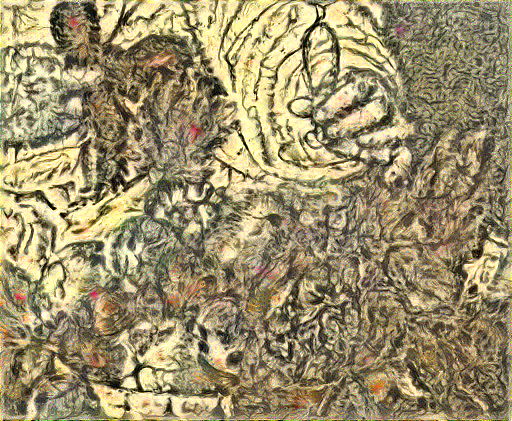

Train step: 50
Total time: 74.3


In [74]:
import time
start = time.time()

epochs = 5
steps_per_epoch = 10

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

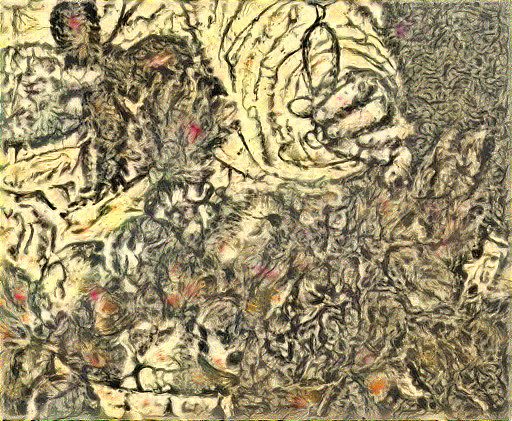

Train step: 100
Total time: 151.1


In [75]:
import time
start = time.time()

epochs = 100
steps_per_epoch = 1

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))